In [1]:
# umpire strike zone tendencies

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import pybaseball as pyb

In [2]:
pyb.cache.enable()


In [3]:
# collect all pitches from regular seasons games
df = pyb.statcast(start_dt='2021-03-21', end_dt='2021-10-05').query('game_type=="R"')

# Does the row count look reasonable?
df.shape, df.shape[0]/30/162

This is a large query, it may take a moment to complete


100%|██████████| 199/199 [00:05<00:00, 38.97it/s]


((709851, 92), 146.05987654320987)

In [4]:
df.sample(12)

,pitch_type,game_date,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,description,...,fld_score,post_away_score,post_home_score,post_bat_score,post_fld_score,if_fielding_alignment,of_fielding_alignment,spin_axis,delta_home_win_exp,delta_run_exp
367,SL,2021-08-28,77.1,-3.19,5.67,"Mills, Alec",571718,621219,None,foul,...,7,7,0,0,7,Infield shift,Standard,47,0.0,0.0
2501,FC,2021-05-12,88.3,-0.58,6.02,"Helsley, Ryan",541645,664854,home_run,hit_into_play,...,1,1,4,4,1,Standard,Standard,181,0.106,1.785
946,CH,2021-07-04,79.6,-2.04,6.21,"Hendricks, Kyle",553993,543294,None,foul,...,2,2,1,1,2,Infield shift,Standard,220,0.0,-0.027
26,FF,2021-09-05,94.4,2.54,5.99,"Ray, Robbie",592192,592662,None,called_strike,...,8,0,8,0,8,Standard,Standard,146,0.0,-0.065
2964,FF,2021-09-26,93.8,-2.63,5.55,"Widener, Taylor",666158,642203,None,foul,...,0,3,0,3,0,Standard,Standard,216,0.0,0.0
2762,KC,2021-04-13,79.2,-1.99,5.14,"Nola, Aaron",624413,605400,None,foul,...,0,0,0,0,0,Standard,Standard,49,0.0,0.0
4048,CU,2021-06-25,78.3,-1.72,5.75,"Germán, Domingo",657077,593334,None,ball,...,0,0,0,0,0,Strategic,Standard,41,0.0,0.055
1362,FF,2021-09-13,91.2,2.56,5.79,"Raley, Brooks",669256,548384,None,foul,...,15,15,1,1,15,Standard,Standard,127,0.0,0.0
1365,SL,2021-08-06,87.5,0.22,6.51,"Means, John",664040,607644,field_out,hit_into_play,...,3,2,3,2,3,Infield shift,Standard,193,0.033,-0.216
3759,FF,2021-06-27,95.1,-0.27,6.76,"Fairbanks, Pete",664058,664126,None,foul,...,4,5,4,5,4,Standard,Strategic,187,0.0,-0.035


In [5]:
# game_pk is the game ID (primary key, I guess)
# how many games?  do the pitches per game look reasonable
df['game_pk'].value_counts()

632764    489
633588    438
633305    432
633874    427
634356    422
         ... 
632963    177
633481    177
632679    175
634423    174
633922    164
Name: game_pk, Length: 2429, dtype: Int64

In [6]:
df['description'].value_counts()

ball                       236920
foul                       125997
hit_into_play              121707
called_strike              116618
swinging_strike             75731
blocked_ball                17316
foul_tip                     6732
swinging_strike_blocked      4713
hit_by_pitch                 2112
foul_bunt                    1569
missed_bunt                   361
bunt_foul_tip                  41
pitchout                       33
foul_pitchout                   1
Name: description, dtype: int64

In [7]:
df[['zone', 'des', 'game_type', 'stand', 'p_throws']]

,zone,des,game_type,stand,p_throws
2940,1,"Francisco Lindor grounds out, third baseman Eh...",R,R,L
3089,4,"Francisco Lindor grounds out, third baseman Eh...",R,R,L
3203,5,"Francisco Lindor grounds out, third baseman Eh...",R,R,L
3443,12,"Francisco Lindor grounds out, third baseman Eh...",R,R,L
3564,4,"Brandon Nimmo grounds out, second baseman Ozzi...",R,L,L
...,...,...,...,...,...
3563,2,Mookie Betts singles on a fly ball to left fie...,R,R,R
3667,12,Mookie Betts singles on a fly ball to left fie...,R,R,R
3744,11,Mookie Betts singles on a fly ball to left fie...,R,R,R
3916,5,Mookie Betts singles on a fly ball to left fie...,R,R,R


In [8]:
df['stand'].value_counts()

R    419978
L    289873
Name: stand, dtype: int64

In [9]:
STRIKE = 'strike'
BALL = 'ball'

In [10]:

pit = df

In [11]:
pit['call'] = pit['description'].apply(lambda x: {'called_strike': STRIKE, 'ball': BALL, 'blocked_ball': BALL}.get(x, None))
pit

,pitch_type,game_date,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,description,...,post_away_score,post_home_score,post_bat_score,post_fld_score,if_fielding_alignment,of_fielding_alignment,spin_axis,delta_home_win_exp,delta_run_exp,call
2940,FF,2021-10-03,92.3,1.4,6.8,"Smith, Will",596019,519293,field_out,hit_into_play,...,0,5,0,5,Infield shift,Strategic,148,0.0,-0.073,None
3089,SL,2021-10-03,80.6,1.6,6.64,"Smith, Will",596019,519293,None,foul,...,0,5,0,5,Infield shift,Strategic,315,0.0,-0.027,None
3203,CU,2021-10-03,75.5,1.46,6.88,"Smith, Will",596019,519293,None,foul,...,0,5,0,5,Infield shift,Standard,328,0.0,-0.02,None
3443,CU,2021-10-03,75.0,1.53,6.83,"Smith, Will",596019,519293,None,ball,...,0,5,0,5,Standard,Standard,330,0.0,0.016,ball
3564,FF,2021-10-03,91.2,1.49,6.66,"Smith, Will",607043,519293,field_out,hit_into_play,...,0,5,0,5,Standard,Standard,143,0.002,-0.189,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3563,FF,2021-04-01,95.9,-1.92,6.15,"Márquez, Germán",605141,608566,None,called_strike,...,0,0,0,0,Standard,Standard,212,0.0,-0.077,strike
3667,FF,2021-04-01,95.4,-1.69,6.17,"Márquez, Germán",605141,608566,None,ball,...,0,0,0,0,Strategic,Standard,<NA>,0.0,0.113,ball
3744,FF,2021-04-01,96.1,-1.76,6.27,"Márquez, Germán",605141,608566,None,ball,...,0,0,0,0,Strategic,Standard,208,0.0,0.052,ball
3916,FF,2021-04-01,95.6,-2.04,6.03,"Márquez, Germán",605141,608566,None,foul,...,0,0,0,0,Standard,Standard,195,0.0,-0.049,None


In [12]:
pit['call'].value_counts()

ball      254236
strike    116618
Name: call, dtype: int64

## Let's make some scatter plots of pitches, from which to infer the strike zone

In [13]:
grph = pit[['plate_x', 'plate_z', 'stand', 'call', 'pitch_type']].dropna()
grph['pt_size']=.01
grph

,plate_x,plate_z,stand,call,pitch_type,pt_size
3443,2.1,3.89,R,ball,CU,0.01
3675,-1.04,3.58,L,ball,FF,0.01
3984,0.12,1.99,L,strike,SL,0.01
4151,-0.72,2.77,L,strike,FF,0.01
2627,-0.02,1.64,R,strike,SI,0.01
...,...,...,...,...,...,...
3049,0.91,2.97,R,strike,SL,0.01
3563,0.07,3.09,R,strike,FF,0.01
3667,0.52,3.95,R,ball,FF,0.01
3744,-0.61,3.65,R,ball,FF,0.01


In [14]:
# Let's define a common way to do this, and apply it for the totals
def make_plot(grph):
    fig = px.scatter(grph, x='plate_x', y='plate_z', color='call', size='pt_size')
    fig.update_traces(marker={'size': 2})
    fig.update_layout(xaxis_range=[-4,4], yaxis_range=[-2,6])
    fig.update_layout(
        autosize=False,
        width=500,
        height=500)
    return fig

make_plot(grph).show()

In [15]:
# OK, now split by LHB vs RHB
for stand in ['L', 'R']:
    make_plot(grph.query('stand == @stand')).show()

In [16]:
grph.query('call == "strike"')[['plate_x', 'plate_z']].describe()

,plate_x,plate_z
count,116567.000000,116567.000000
mean,0.013250,2.365473
std,0.542612,0.546213
min,-1.430000,0.000000
25%,-0.440000,1.920000
50%,0.020000,2.320000
75%,0.470000,2.790000
max,1.510000,4.470000


In [17]:
grph['plate_x'] = grph['plate_x'].apply(float)
grph['plate_z'] = grph['plate_z'].apply(float)
grph['strike'] = np.where(grph['call']=='strike', 1, 0)

In [18]:
pits = grph.query("-1.5 < plate_x < 1.5 and 1 < plate_z < 4")
pits

,plate_x,plate_z,stand,call,pitch_type,pt_size,strike
3675,-1.04,3.58,L,ball,FF,0.01,0
3984,0.12,1.99,L,strike,SL,0.01,1
4151,-0.72,2.77,L,strike,FF,0.01,1
2627,-0.02,1.64,R,strike,SI,0.01,1
3981,-0.92,2.61,L,strike,CU,0.01,1
...,...,...,...,...,...,...,...
1969,-0.23,2.78,L,strike,SL,0.01,1
3049,0.91,2.97,R,strike,SL,0.01,1
3563,0.07,3.09,R,strike,FF,0.01,1
3667,0.52,3.95,R,ball,FF,0.01,0


In [19]:

bins_x  = pd.cut(pits['plate_x'], bins=60)
bins_z  = pd.cut(pits['plate_z'], bins=60)

pits.groupby(bins_x)['strike'].mean()
pits.groupby(bins_z)['strike'].mean()

plate_z
(1.007, 1.06]     0.000283
(1.06, 1.109]     0.001602
(1.109, 1.159]    0.002308
(1.159, 1.209]    0.006413
(1.209, 1.258]    0.017356
(1.258, 1.308]    0.040920
(1.308, 1.358]    0.081315
(1.358, 1.407]    0.144545
(1.407, 1.457]    0.201769
(1.457, 1.507]    0.302316
(1.507, 1.556]    0.396174
(1.556, 1.606]    0.484831
(1.606, 1.656]    0.530220
(1.656, 1.705]    0.576430
(1.705, 1.755]    0.604555
(1.755, 1.805]    0.639140
(1.805, 1.854]    0.662286
(1.854, 1.904]    0.654435
(1.904, 1.954]    0.662823
(1.954, 2.003]    0.680543
(2.003, 2.053]    0.682447
(2.053, 2.103]    0.671002
(2.103, 2.152]    0.680576
(2.152, 2.202]    0.670865
(2.202, 2.252]    0.672582
(2.252, 2.301]    0.671375
(2.301, 2.351]    0.664325
(2.351, 2.401]    0.664175
(2.401, 2.45]     0.667250
(2.45, 2.5]       0.658713
(2.5, 2.55]       0.647044
(2.55, 2.599]     0.651099
(2.599, 2.649]    0.647485
(2.649, 2.699]    0.647730
(2.699, 2.748]    0.637328
(2.748, 2.798]    0.641458
(2.798, 2.848]    0.

<ipython-input-20-e96fd96ecdf6>:11: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



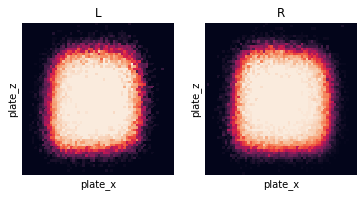

In [20]:
num_bins = 60

fig, ax = plt.subplots(1,2)
for i, stand in enumerate(['L', 'R']):
    ppits = pits.query('stand == @stand')
    bins_x  = pd.cut(ppits['plate_x'], bins=num_bins)
    bins_z  = pd.cut(ppits['plate_z'], bins=num_bins)
    hmap  = ppits.groupby([bins_z, bins_x])['strike'].mean().unstack().sort_index(level=0, ascending=False)
    sns.heatmap(hmap, ax=ax[i], square=True, xticklabels=False, yticklabels=False, cbar=False)
    ax[i].set_title(stand)
fig.show()



<AxesSubplot:xlabel='plate_x', ylabel='plate_z'>

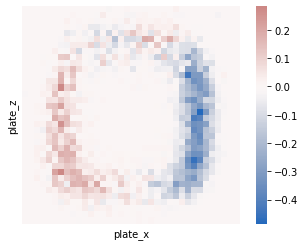

In [21]:
num_bins = 36

def get_heatmap(stand):
    ppits = pits.query('stand == @stand')
    bins_x  = pd.cut(ppits['plate_x'], bins=num_bins)
    bins_z  = pd.cut(ppits['plate_z'], bins=num_bins)
    hmap  = ppits.groupby([bins_z, bins_x])['strike'].mean().unstack().sort_index(level=0, ascending=False)
    return hmap

hmaps = {stand: get_heatmap(stand) for stand in ['L', 'R']}

zone_diff = hmaps['L'] - hmaps['R']
sns.heatmap(zone_diff, center=0, cmap="vlag", square=True, xticklabels=False, yticklabels=False)



In [22]:
fig = px.imshow(zone_diff.reset_index(drop=True).T.reset_index(drop=True).T, color_continuous_scale='RdBu', color_continuous_midpoint=0,
    x=list(range(-18, 18)),
#    y=list(range(48, 12, -1)),
    labels = {'x': 'plate_x', 'y': 'plate_z', 'color': 'diff'}
    )

#fig.update_yaxes(autorange="reversed") # why isn't this working in the right direction?

fig.add_shape(type="rect",
    x0=-8.5, y0=30, x1=8.5, y1=10,
    line=dict(color="Black",width=3)
)


fig.show()

In [23]:
hmap.reset_index(drop=True).T.reset_index(drop=True)

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.035714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.029412,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.031250,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [24]:
px.imshow(hmap.reset_index(drop=True).T.reset_index(drop=True).T)